In [94]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib as mpl

from matplotlib import pyplot as plt
from keplergl import KeplerGl
from pandas_profiling import ProfileReport

%matplotlib inline
mpl.style.use("seaborn")

print("Pandas Version: " + pd.__version__)
print("Numpy Version: " + np.__version__)
print("Seaborn Version: " + sns.__version__)

Pandas Version: 1.2.0
Numpy Version: 1.18.5
Seaborn Version: 0.11.1


In [95]:
trips = pd.read_csv("../data/clean/trips.csv", parse_dates=["date_from", "date_until"])
trips.head(3)

,bike_id,user_id,date_from,date_until,start_station_name,start_station_id,end_station_name,end_station_id,booked_via,duration_in_min,distance_in_km,speed_in_kmh
0,143517,A821059B555C7764A2FF801180874A2FCB326222,2014-01-01 00:34:54,2014-01-01 00:50:14,U-Bahn Baumwall,214170,Mönckebergstraße / Rosenstraße,131880,iPhone SRH,16,1.293661,4.851229
1,119830,1EBC930DB407ACEAE2FDE23A6CA40492EA3DFBB2,2014-01-01 01:39:55,2014-01-01 01:57:27,Bahnhof Altona Ost/Max-Brauer-Allee,131646,Schulterblatt/Eifflerstraße,131648,Android SRH,18,2.032271,6.774236
2,143501,7AD2C1B70137479062A6DD73815835986677BB2D,2014-01-01 01:40:20,2014-01-01 01:53:09,Weidestraße/Biedermannplatz,211922,Jarrestraße / Rambatzweg,138376,Techniker HH_119 (-2334-),13,0.954178,4.403899


In [96]:
users = pd.read_csv("../data/clean/users.csv", parse_dates=["date_from_min", "date_from_max"], index_col="user_id")
users.head(3)

,date_from_min,date_from_max,trips_count,active_period_in_days,days_since_first_activity,days_since_last_activity,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh
user_id,,,,,,,,,
0000020B772C8D71F4F9AE4835D6C9F032FDBE21,2014-08-03 00:43:54,2017-05-12 19:42:34,66,1013,1017,3,12.393939,1.659699,8.258637
000004354587D5BAC99A2171DE2F4ACD30AA8635,2014-03-10 08:42:55,2016-11-17 12:11:25,8,983,1162,179,15.625000,0.953377,3.693612
00005721E978458AD348C24219138429BC84574A,2016-06-19 21:02:32,2017-05-15 16:05:15,99,329,330,0,10.252525,1.439436,8.760295


In [97]:
stations = pd.read_csv("../data/clean/stations.csv")
stations = stations[["station_id", "name", "latitude", "longitude"]]
stations.head(3)

,station_id,name,latitude,longitude
0,131543,Landungsbrücke/Hafentor,53.5457,9.97230
1,131546,Fischmarkt/Breite Straße,53.5462,9.95088
2,131547,Paulinenplatz/Wohlwillstraße,53.5542,9.96246


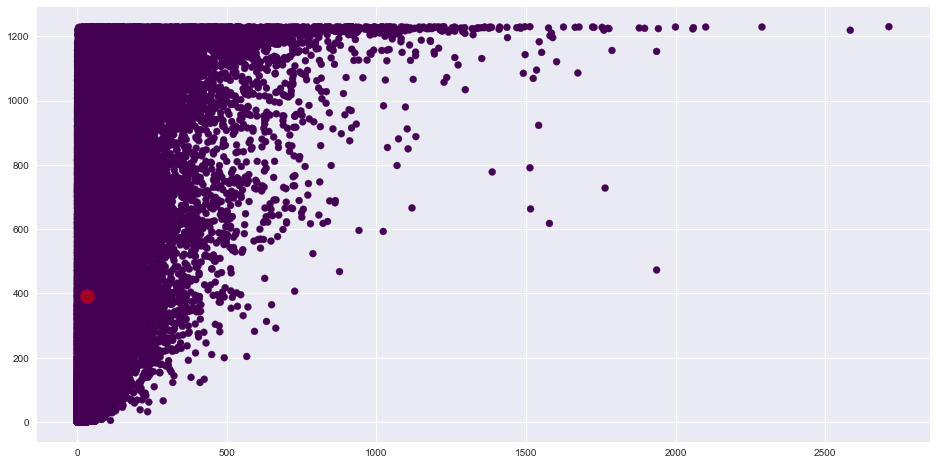

In [98]:
from sklearn.cluster import KMeans

features = (
    users.trips_count, 
    users.active_period_in_days, 
    users.mean_duration_in_min, 
    users.mean_distance_in_km, 
    users.mean_speed_in_kmh,
)
X = np.column_stack(features)
clusters = 1

kmeans = KMeans(clusters)
kmeans.fit(X)
y_kmeans = kmeans.fit_predict(X)
centers = kmeans.cluster_centers_

plt.figure(figsize=(16,8))
plt.scatter(X[:, 0], X[:, 1], c=y_kmeans, cmap="viridis")
plt.scatter(centers[:, 0], centers[:, 1], s=200, alpha=0.5, c="red");

In [99]:
#from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier

scaler = StandardScaler()
knn = KNeighborsClassifier(n_neighbors=15)

#data = users[["trips_count", "mean_duration_in_min", "mean_distance_in_km", "mean_speed_in_kmh"]]

#pipeline = Pipeline([("knn", knn)])
#pipeline = make_pipeline(scaler, knn)
#pipeline.fit(data)

In [100]:
# Labelling users as 'casual' or 'regular' based on activity patterns.

REGULAR_USER_ACTIVE_DAYS_MIN = 28
REGULAR_USER_THRESHOLD = 4

def label_user_type(user):
    if (
        (user.active_period_in_days / user.trips_count) <= REGULAR_USER_THRESHOLD
    ) & (
        user.active_period_in_days >= REGULAR_USER_ACTIVE_DAYS_MIN
    ):
        return "regular"
    else:
        return "casual"

users["type"] = users.apply(label_user_type, axis=1)

In [101]:
regular_users = users[users.type == "regular"]
casual_users = users[users.type == "casual"]

In [102]:
regular_users.sample(5)

,date_from_min,date_from_max,trips_count,active_period_in_days,days_since_first_activity,days_since_last_activity,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh,type
user_id,,,,,,,,,,
72F766B4F2C4EA616D79EB0D03AE281DC433EDD4,2016-10-20 17:00:38,2017-05-10 18:33:50,52,202,207,5,18.730769,2.502403,8.064950,regular
C5945CF3499C9706EB7B0E9ABBF145D578F04895,2014-10-21 12:42:19,2015-05-15 17:03:49,80,206,937,731,11.287500,1.221252,6.772027,regular
211256927AB93F2B73083CDC72A27558EC1F188D,2015-03-11 10:43:29,2015-04-09 16:43:57,12,29,796,767,19.583333,1.974878,5.847429,regular
E189CC1A0E484B5CA4A84E754521FB82D9AC511D,2016-07-26 19:05:02,2017-05-14 13:36:40,193,291,293,1,12.803109,2.086819,9.918547,regular
85157ED82380AFD70D434CE74FB64A05752194F5,2016-06-17 14:58:27,2017-05-14 16:02:00,260,331,332,1,20.292308,4.165019,12.322930,regular


In [103]:
casual_users.sample(5)

,date_from_min,date_from_max,trips_count,active_period_in_days,days_since_first_activity,days_since_last_activity,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh,type
user_id,,,,,,,,,,
8086CFCC40D83EB342F502AE8189B1941DF39B6A,2015-05-21 18:47:32,2015-07-11 18:53:26,6,51,725,674,12.500000,1.687069,8.151723,casual
D823D2F41F29A7191E7E25D90A8928F490AD9808,2014-10-10 15:32:41,2017-05-12 14:40:41,67,944,948,3,17.522388,1.909698,6.718880,casual
C837BEE0D09374D97AC941733CA9191BD6B85EE7,2016-07-22 14:46:57,2017-01-16 17:26:34,8,178,297,119,14.250000,2.049481,8.714278,casual
21E2B30048F4932A008C4827A9CA3F5B851B4B91,2015-06-19 15:47:57,2016-08-31 11:53:00,58,438,696,257,10.517241,1.327520,7.749246,casual
4684234B9EF13F4FCAAE91346C95DA2B21079948,2014-01-17 16:26:04,2016-11-16 15:47:30,12,1033,1214,180,14.666667,1.747601,7.536014,casual


<AxesSubplot:xlabel='mean_duration_in_min', ylabel='Count'>

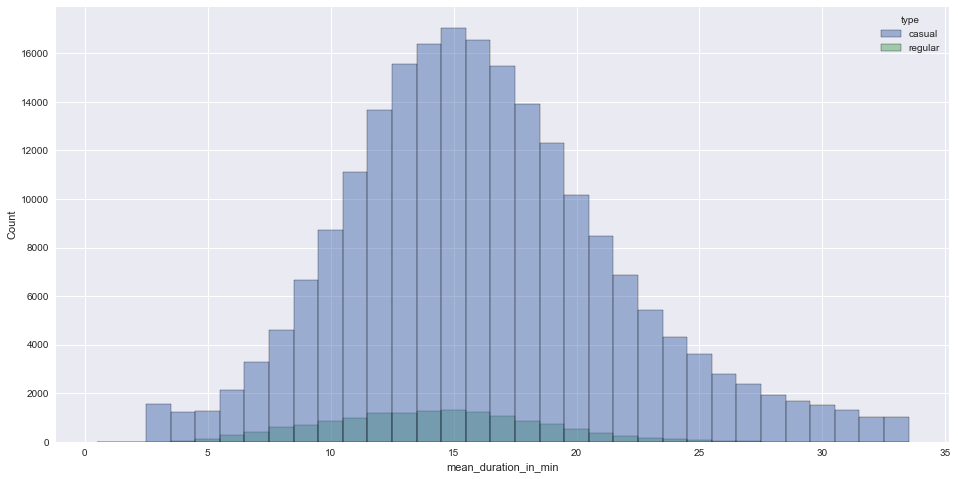

In [104]:
plt.figure(figsize=(16, 8))
sns.histplot(users, x="mean_duration_in_min", hue="type", element="bars", discrete=True)

<AxesSubplot:xlabel='mean_duration_in_min', ylabel='Count'>

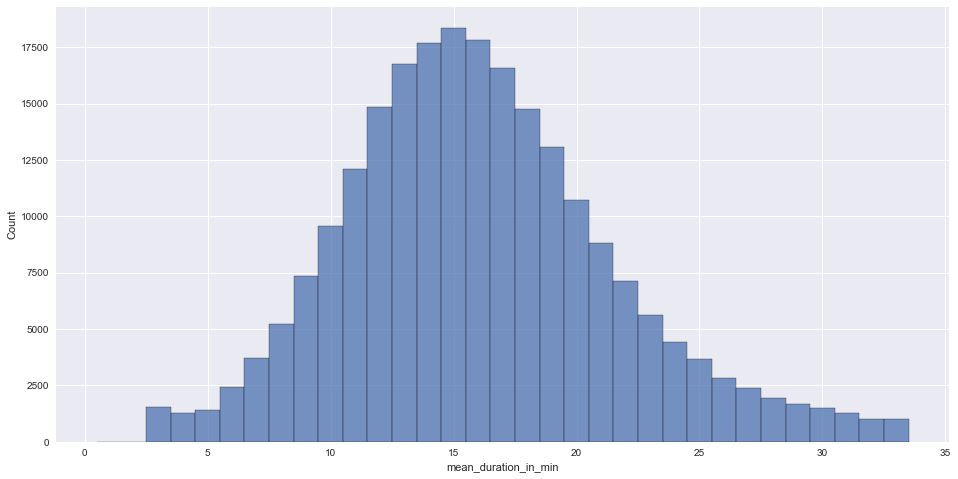

In [105]:
plt.figure(figsize=(16, 8))
sns.histplot(users, x="mean_duration_in_min", element="bars", discrete=True)

<AxesSubplot:xlabel='mean_distance_in_km', ylabel='Count'>

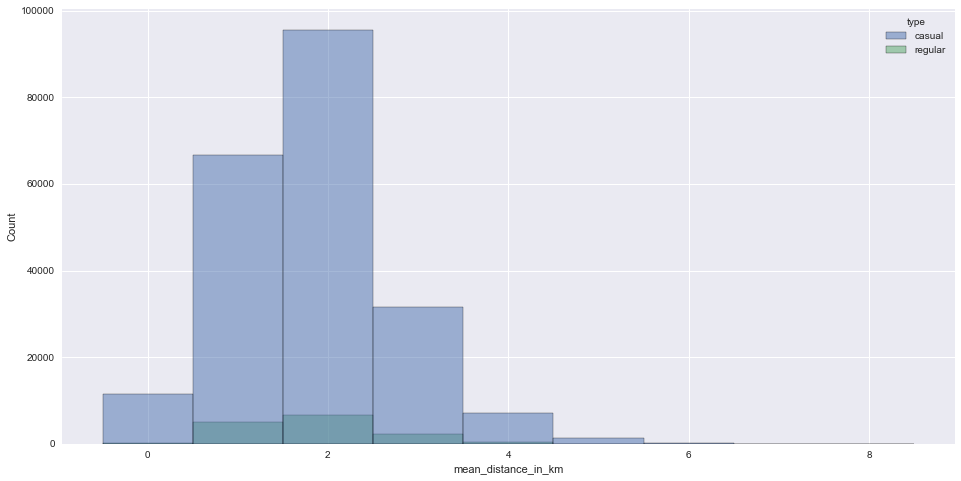

In [106]:
plt.figure(figsize=(16, 8))
sns.histplot(users, x="mean_distance_in_km", hue="type", element="bars", discrete=True)

<AxesSubplot:xlabel='mean_distance_in_km', ylabel='Count'>

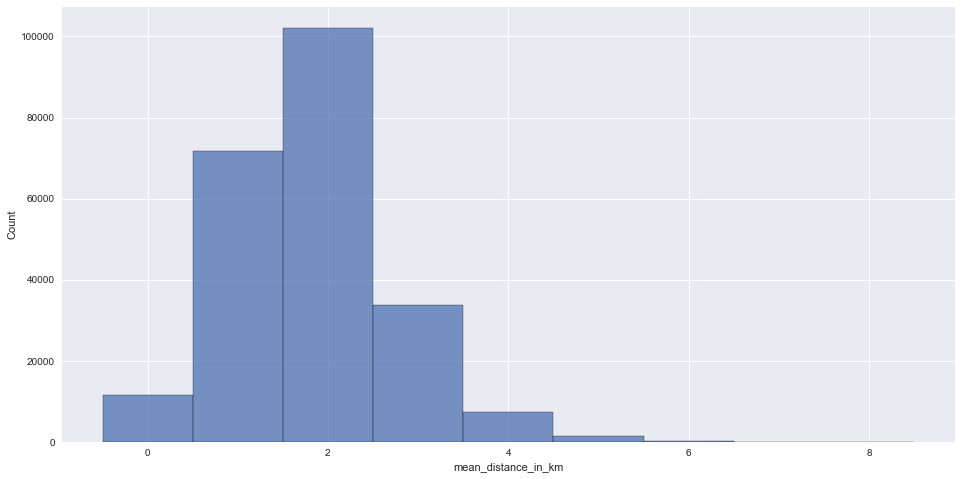

In [107]:
plt.figure(figsize=(16, 8))
sns.histplot(users, x="mean_distance_in_km", element="bars", discrete=True)

<AxesSubplot:xlabel='mean_speed_in_kmh', ylabel='Count'>

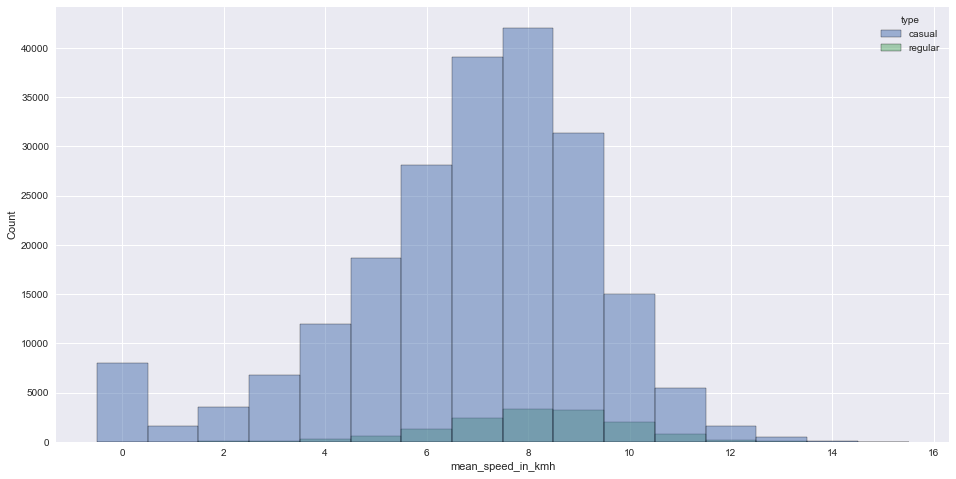

In [108]:
plt.figure(figsize=(16, 8))
sns.histplot(users, x="mean_speed_in_kmh", hue="type", element="bars", discrete=True)

<AxesSubplot:xlabel='mean_speed_in_kmh', ylabel='Count'>

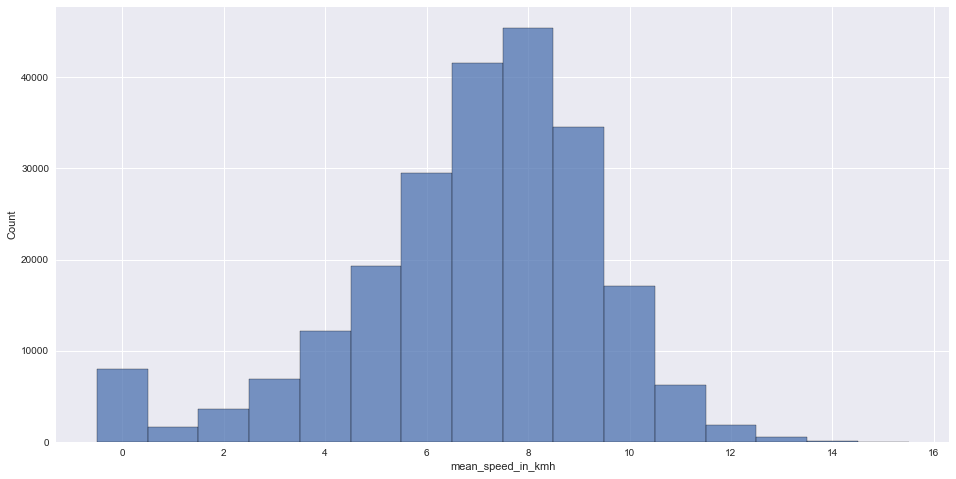

In [109]:
plt.figure(figsize=(16, 8))
sns.histplot(users, x="mean_speed_in_kmh", element="bars", discrete=True)

In [110]:
trips = trips.merge(users[["type"]], left_on="user_id", right_index=True)
trips.sample(5)

,bike_id,user_id,date_from,date_until,start_station_name,start_station_id,end_station_name,end_station_id,booked_via,duration_in_min,distance_in_km,speed_in_kmh,type
6110443,109259,519276277253C8D160AAE8BCD7BC4E401B64048B,2016-09-13 18:22:35,2016-09-13 18:29:36,Lange Reihe / Kirchenallee,138384,Amsinckstraße/ Nordkanalbrücke,218174,Android SRH,8,0.861369,6.460271,casual
5438825,106181,DDE8E77C913E92344C2FDB0389E76D4E34240998,2016-07-05 17:38:05,2016-07-05 17:57:51,Hofweg/Am Langenzug,200502,Eduard-Rhein-Ufer / Schwanenwik,140800,Android SRH,20,1.159492,3.478477,regular
5914860,113167,A33D28F0174ED8BAABE83C1EB8EA3619E9AA32AF,2016-08-25 17:28:09,2016-08-25 17:31:25,Winterhuder Weg/ Zimmerstraße,208292,Mundsburg / Schürbeker Straße,140799,Terminal HH_113 (-2326-),4,0.773082,11.596233,regular
5147830,106989,C09B5EAB53E71A2FDEF3C32FE03F336CF9ED90C1,2016-06-04 13:40:24,2016-06-04 13:44:59,Hauptbahnhof Ost / Hachmannplatz,131873,Lange Reihe / Lohmühlenpark,138385,Terminal HH_34 (-2541-),5,0.786254,9.435050,casual
814612,143695,01E1DCCBB13153EFD20BAAF7211EC6FF78344C05,2014-06-08 13:21:19,2014-06-08 13:46:04,Osterstraße/Bismarckstraße,131642,U-Bahn Baumwall,214170,Terminal HH_6 (-2223-),25,3.442628,8.262308,casual


<AxesSubplot:xlabel='duration_in_min', ylabel='Count'>

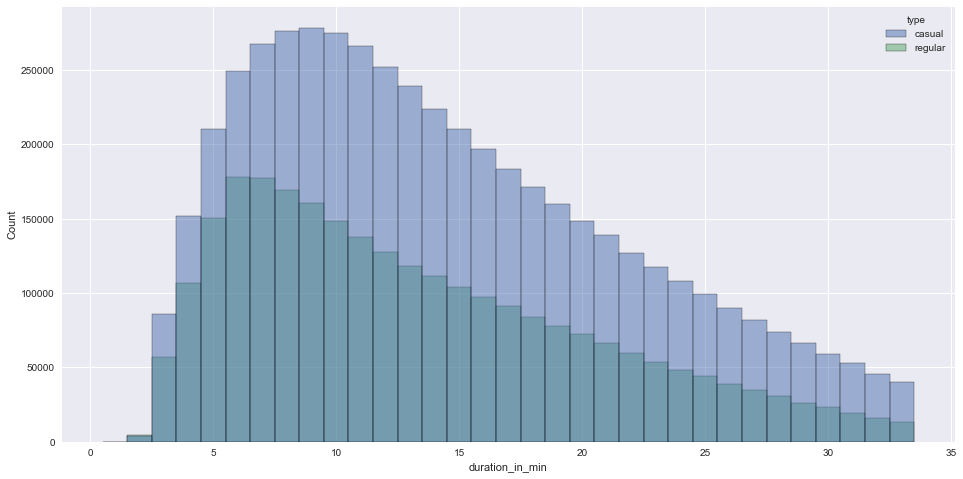

In [111]:
plt.figure(figsize=(16, 8))
sns.histplot(trips, x="duration_in_min", hue="type", element="bars", discrete=True)

<AxesSubplot:xlabel='distance_in_km', ylabel='Count'>

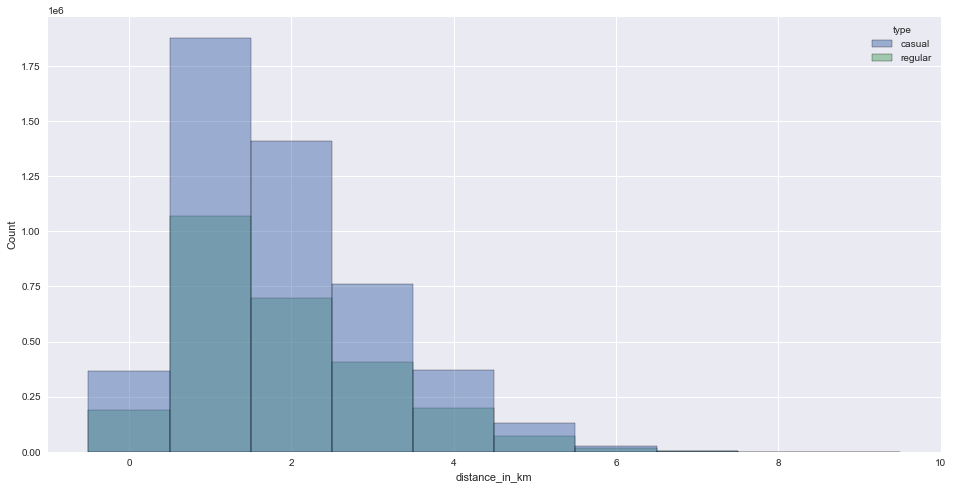

In [112]:
plt.figure(figsize=(16, 8))
sns.histplot(trips, x="distance_in_km", hue="type", element="bars", discrete=True)

<AxesSubplot:xlabel='speed_in_kmh', ylabel='Count'>

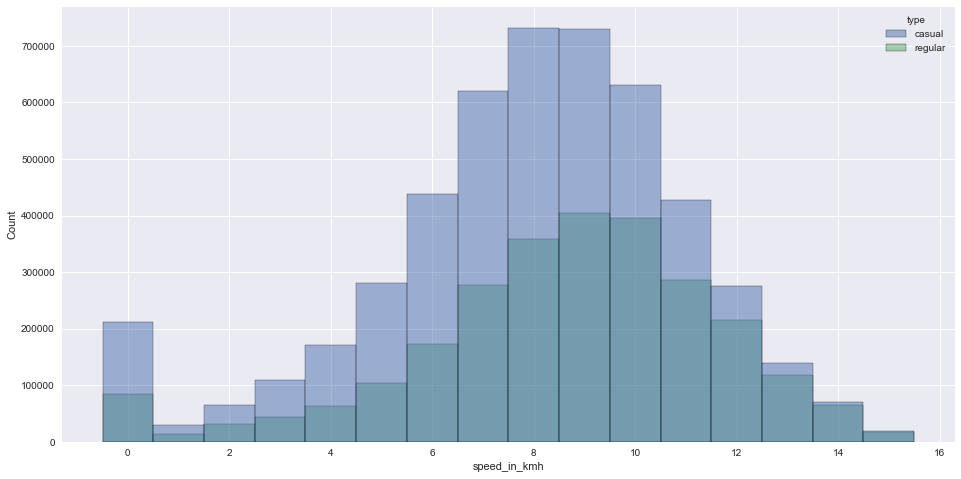

In [113]:
plt.figure(figsize=(16, 8))
sns.histplot(trips, x="speed_in_kmh", hue="type", element="bars", discrete=True)

In [114]:
trips[trips.type == "casual"].describe()

,bike_id,start_station_id,end_station_id,duration_in_min,distance_in_km,speed_in_kmh
count,4.953398e+06,4.953398e+06,4.953398e+06,4.953398e+06,4.953398e+06,4.953398e+06
mean,1.215056e+05,1.690050e+05,1.696436e+05,1.448536e+01,1.869487e+00,7.948386e+00
std,1.075194e+04,4.131277e+04,4.140850e+04,7.440743e+00,1.191247e+00,3.041942e+00
min,1.060220e+05,1.315430e+05,1.315430e+05,1.000000e+00,0.000000e+00,0.000000e+00
25%,1.172390e+05,1.318850e+05,1.318870e+05,8.000000e+00,9.795859e-01,6.367800e+00
50%,1.199440e+05,1.407950e+05,1.407960e+05,1.300000e+01,1.607519e+00,8.260301e+00
75%,1.205240e+05,2.083070e+05,2.117060e+05,2.000000e+01,2.559422e+00,9.986389e+00
max,1.438660e+05,2.683580e+05,2.683580e+05,3.300000e+01,8.217026e+00,1.499991e+01


In [115]:
trips[trips.type == "regular"].describe()

,bike_id,start_station_id,end_station_id,duration_in_min,distance_in_km,speed_in_kmh
count,2.652580e+06,2.652580e+06,2.652580e+06,2.652580e+06,2.652580e+06,2.652580e+06
mean,1.209009e+05,1.711749e+05,1.709037e+05,1.330464e+01,1.863193e+00,8.626161e+00
std,1.073214e+04,4.192748e+04,4.183105e+04,7.204683e+00,1.211558e+00,3.013891e+00
min,1.060220e+05,1.315430e+05,1.315430e+05,1.000000e+00,0.000000e+00,0.000000e+00
25%,1.160120e+05,1.318870e+05,1.318870e+05,7.000000e+00,9.424613e-01,7.063288e+00
50%,1.198710e+05,1.407990e+05,1.407960e+05,1.200000e+01,1.562930e+00,8.948365e+00
75%,1.204920e+05,2.117090e+05,2.117090e+05,1.800000e+01,2.567121e+00,1.062967e+01
max,1.438660e+05,2.683580e+05,2.683580e+05,3.300000e+01,8.194410e+00,1.499974e+01


<Figure size 1152x576 with 0 Axes>

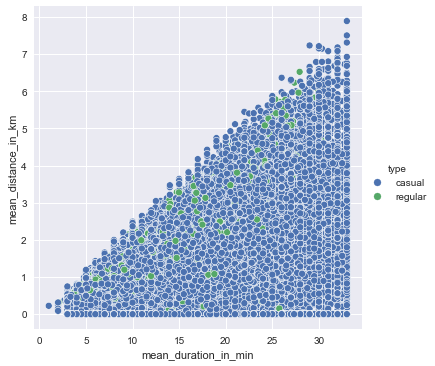

In [116]:
plt.figure(figsize=(16, 8))
sns.relplot(data=users, x="mean_duration_in_min", y="mean_distance_in_km", hue="type")

<Figure size 1152x576 with 0 Axes>

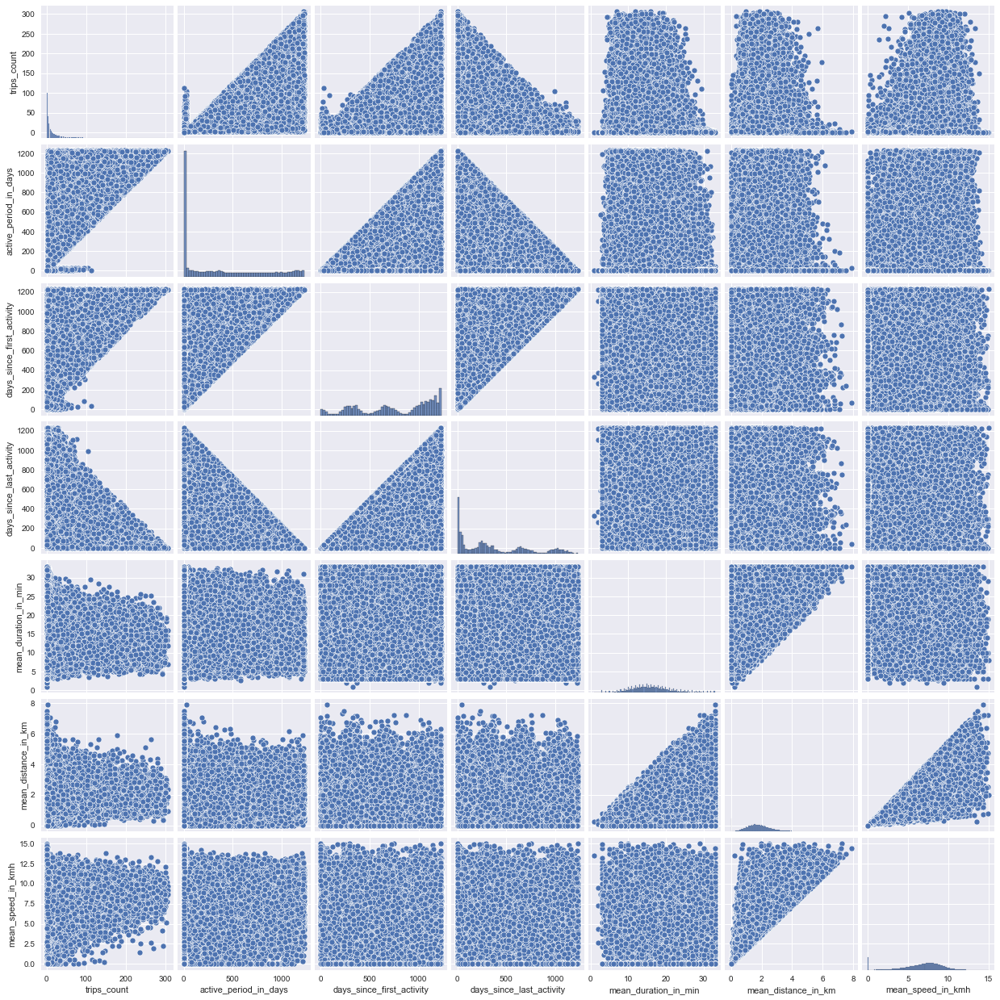

In [117]:
plt.figure(figsize=(16, 8))
sns.pairplot(users[users.type == "casual"])

<Figure size 1152x576 with 0 Axes>

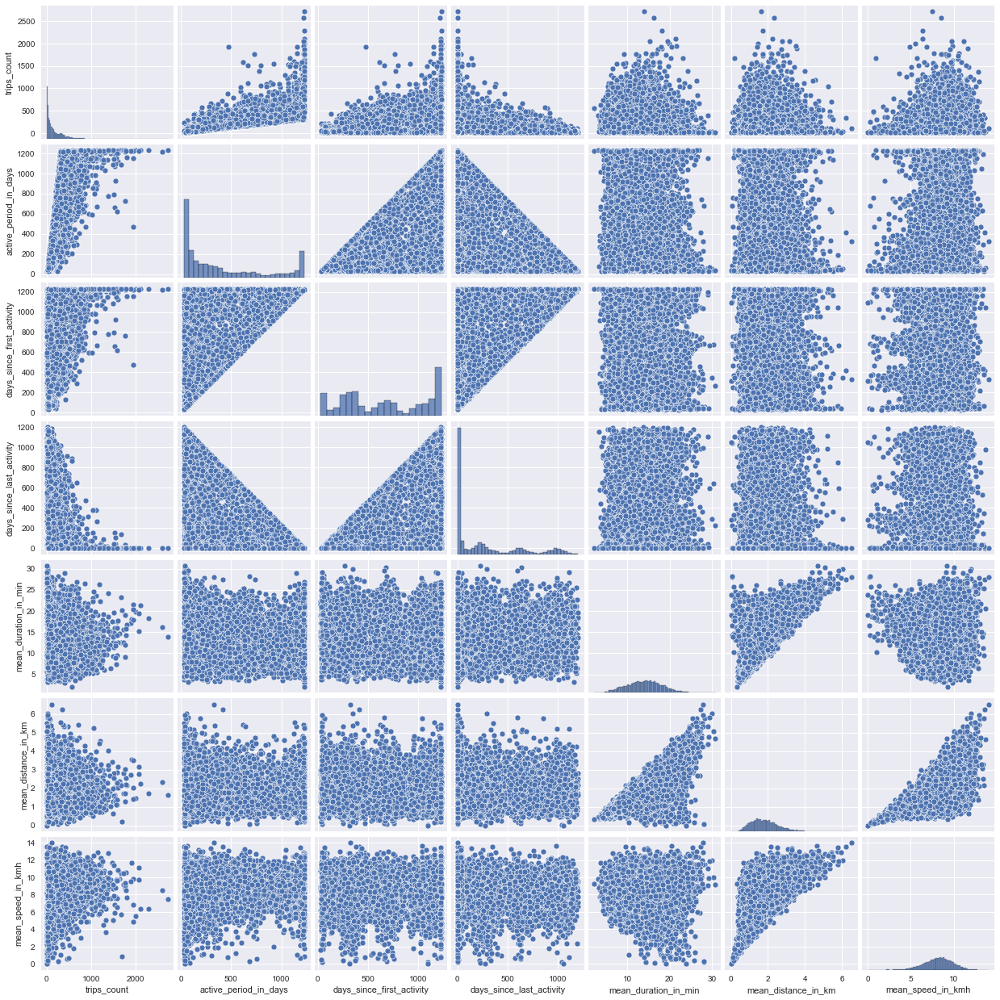

In [118]:
plt.figure(figsize=(16, 8))
sns.pairplot(users[users.type == "regular"])

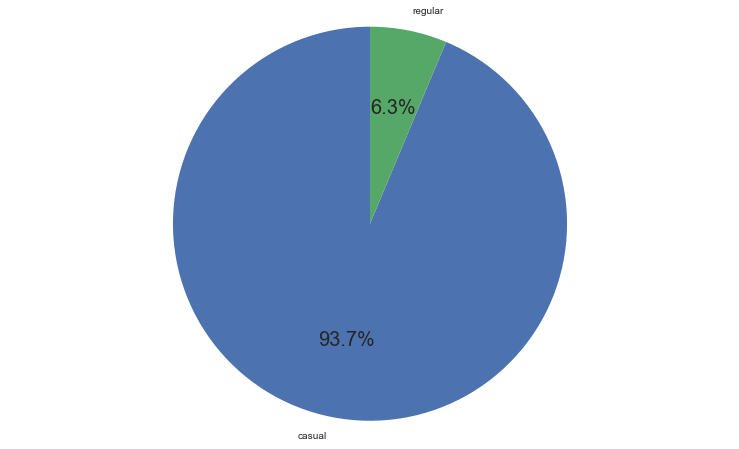

In [193]:
# How many users are labelled as casual/regular?
plt.rcParams.update({'font.size': 20})

value_counts = users.groupby("type").size()
fig, ax = plt.subplots(figsize=(13,8))
ax.pie(value_counts, labels=value_counts.index, autopct="%1.1f%%", startangle=90)
ax.axis("equal")
plt.savefig("figures/trips_by_user_types.png", bbox_inches="tight")
plt.show()

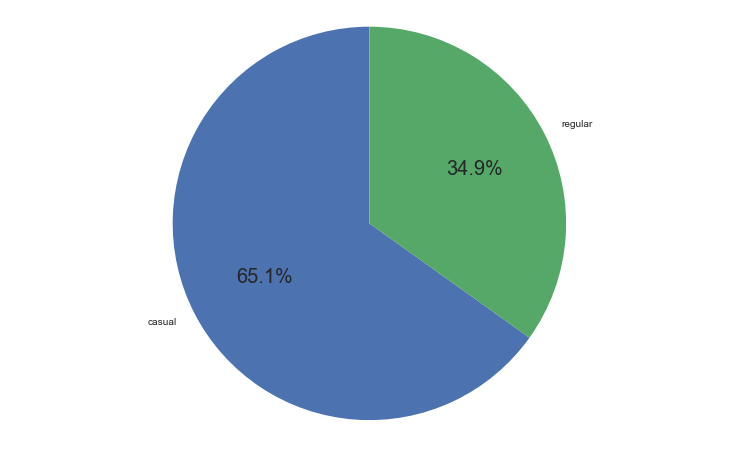

In [194]:
# How many trips are labelled as casual/regular?

value_counts = trips.groupby("type").size()
fig, ax = plt.subplots(figsize=(13,8))
ax.pie(value_counts, labels=value_counts.index, autopct="%1.1f%%", startangle=90)
ax.axis("equal")
plt.savefig("figures/users_by_types.png", bbox_inches="tight")
plt.show()

In [138]:
tmp = trips.copy()
tmp.loc[trips.booked_via.str.startswith("Terminal"), "booked_via"] = "Terminal"
tmp.loc[trips.booked_via.str.startswith("terminal"), "booked_via"] = "Terminal"
tmp.loc[trips.booked_via.str.startswith("Techniker"), "booked_via"] = "Techniker"
tmp.loc[trips.booked_via.str.startswith("Starenkasten"), "booked_via"] = "Starenkasten"

rarely_used_booked_via = [
    'Android',
    'BlackBerry',
    'Windows',
    'iPhone KON',
    'CaB - Mobility Map',
    'LIDL-BIKE',
    'Android KON',
    'Starenkasten'
]

tmp["booked_via"] = tmp[["booked_via"]].replace(rarely_used_booked_via, "Other")

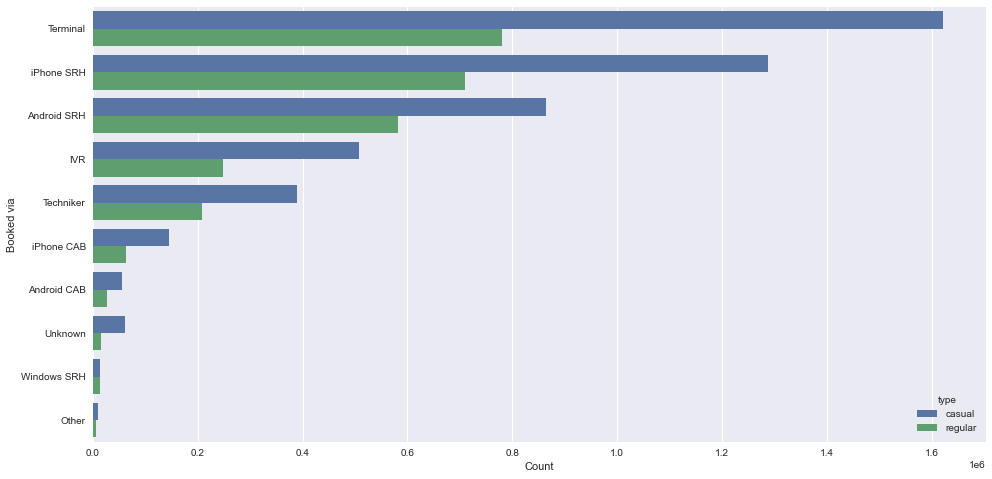

In [141]:
plt.figure(figsize=(16,8))
ax = sns.countplot(
    data=tmp,
    y="booked_via",
    hue="type",
    order = tmp.booked_via.value_counts().index
)
ax.set(xlabel="Count", ylabel="Booked via")
plt.savefig("figures/booked_via.png", bbox_inches="tight")
plt.show()